## Unconstrained Optimization Part2 

In this notebook, I implement several optimization algorithms, first testing the benefit of backtracking against constant step size for Gradient Descent and Newton algorithms. Then, we consider the behavior of conjugate-gradient and Polack-Ribière technique that work without knowledge of the Hessian matrix of the function to be optimized.

### IV - Conjugate gradient 
**4)** Implementing the conjugate-gradient algorithm and testing it on a simple quadratic function $p({\bf x})=\frac 1 2 {\bf x^TAx}-{\bf x^Tb}$ with ${\bf A} = [1\; 0;0\; 5]$ and ${\bf b}=[1; 1]$. 

**5)** Let's consider a larger problem where 

        n = 10  # 100
        
        a = randn(n,n)
        
        A = a'*a + diagm(0=>ones(n)) # A = a'*a
        
        b = randn(n)

For $n=10,100$, let's check the influence of the condition number of ${\bf A}$ by adding or removing term **diagm(0=>ones(n))**.

### V - Polak-Ribière
**6)** Considering again the function p, we compare the performance of gradientand Polack-Ribiere algorithms with backtracking and initialization at point $(−4, -2)$. 

### VI - Changing initialization
**7)** What occurs with these algorithms when changing intilialization to point $(-5,-0.5)



### II - Backtracking

In [ ]:
# Backtracking
#-------------
function backtracking(x,f,∇f, d, alpha)
    y=zeros(2) 
    n = 0 
    ρ = 1
    beta = 0.7
    grad_norm = norm(∇f(x[1], x[2])) 
    while f(x[1]+ ρ*d[1],x[2]+ ρ*d[2]) > f(x[1],x[2]) - alpha * ρ * grad_norm
        ρ *= beta # Reduce step size
        n +=1
    end
    y[1] = x[1] + ρ * d[1]
    y[2] = x[2] + ρ * d[2]
    return y,n 
end

In [ ]:
# Gradient algorithm
# with backtracking
#-------------------
pt             = Float64[-4, -2]
function gradient_descent_with_backtracking(f, ∇f, pt, opt, precision, max_iter,alpha) 
    nb_iter_grad   = 0  # number of loops
    nb_loops_grad  = 0  # number of inner loops count for backtracking
    resu_grad      = pt #Trajectory of the algorithm 
    while norm(pt-opt)>precision && nb_iter_grad<max_iter
        nb_iter_grad  += 1
        d = -∇f(pt[1], pt[2]) 
        pt , n = backtracking(pt,f,∇f, d, alpha)
        nb_loops_grad += n 
        resu_grad      = [resu_grad pt]
    end
    return  resu_grad, nb_loops_grad , nb_iter_grad
end

### IV - Conjugate gradient

In [ ]:
using LinearAlgebra: norm

A=[1 0;0 5]
b=[1,1]
p(x,y)  = (1/2) * transpose([x, y]) * A * [x, y] - transpose([x, y]) * b 
∇p(x,y) = A*[x,y] - b 
opt= [1;1/5]

In [ ]:
precision = 1.e-8
max_iter  = 10e4
init      = [-2,3]

# optimal stepsize
pt            = init
nb_opt_grad   = 0 
resu_opt_grad = pt


In [ ]:
resu_opt_grad, nb_loops_grad , nb_opt_grad =  gradient_descent_with_backtracking(p, ∇p, pt, opt, precision, max_iter,0.25) # 0 < alpha < 1/2

In [7]:
println("Error with gradient with optimal stepsize: $(norm(resu_opt_grad[:,end]-opt))")
println("Number of iterations = $nb_opt_grad")

Error with gradient with optimal stepsize: 0.11976014959743839
Number of iterations = 100000


#### GD perfroms poorly for this problem 

In [8]:
# Conjugate gradient
#--------------------
pt          = init
nb_iter_CG  = 0        # number of iterations
nb_loops_CG = 0        # number of inner loops count for backtracking
err_CG      = norm(pt-opt)

# initialization
g_k = ∇p(pt[1],pt[2])   
d_k  = - g_k
resu_CG = pt
# iterations
for k = 1:10
    nb_iter_CG  +=1 
    pt , n = backtracking(pt,p,∇p, d_k, 0.5)
    nb_loops_CG += n 
    g_k1 = ∇p(pt[1],pt[2])  
    beta = (g_k1' * g_k1) / (g_k' * g_k)
    d_k1 = - g_k1 + beta * d_k
    g_k= g_k1
    d_k = d_k1
    resu_CG     = [resu_CG pt]
    err_CG = [err_CG norm(pt-opt)]
end


In [9]:
println("Error with CG: $(err_CG[end])")
println("Error number of iterations with CG: $(nb_iter_CG)")

Error with CG: 0.03075952468988788
Error number of iterations with CG: 10


In [ ]:
# Figure: conjugate gradient with optimal step
x = -20:0.1:20
y = -20:0.1:20
contourf(x,y,p) 
plot!(resu_CG[1, :], resu_CG[2, :], label="CG with Backtracking trajectory", marker=:circle, color=:red, size=(500,300)) 
plot!(resu_opt_grad[1, :], resu_opt_grad[2, :], label="GD with Backtracking trajectory", marker=:circle, color=:green) 

### A larger problem

In [ ]:
function backtracking_n_dim(x,f,∇f, d, alpha)
    dim = length(x) 
    y=zeros(dim) 
    n = 0 
    ρ = 1
    beta = 0.7
    grad_norm = norm(∇f(x)) 
    while f(x+ ρ*d) > f(x) - alpha * ρ * grad_norm
        ρ *= beta # Reduce step size
        n +=1
    end
    y = x+ ρ * d
    return y,n 
end

In [ ]:
using LinearAlgebra: cond, diagm
n = 100
A_100 = randn(n,n)
A_100 = A_100'*A_100 
b_100 = randn(n)

In [ ]:
function h(n, A, b, add_diagm)
    if add_diagm
        A = A+ diagm(0=>ones(n))
    end
    pn(x)  = (1/2) * transpose(x) * A * x - transpose(x) * b 
    ∇pn(x) = A*x - b 
    opt = inv(A) * b 
    
    # initialization
    nb_iter_CG  = 0
    nb_loops_CG = 0
    pt          = randn(n)
    err_CG      = norm(pt.-opt)
    g_k = ∇pn(pt)   
    d_k  = - g_k
    resu_CG = pt  
    # iterations
    for k = 1:n
        nb_iter_CG  +=1 
        pt , n = backtracking_n_dim(pt,pn,∇pn, d_k, 0.25)
        nb_loops_CG += n 
        g_k1 = ∇pn(pt)  
        beta = (g_k1' * g_k1) / (g_k' * g_k)
        d_k1 = - g_k1 + beta * d_k
        g_k= g_k1
        d_k = d_k1
        resu_CG     = [resu_CG pt]
        err_CG = [err_CG;norm(pt.-opt)]
    end
        return err_CG
end


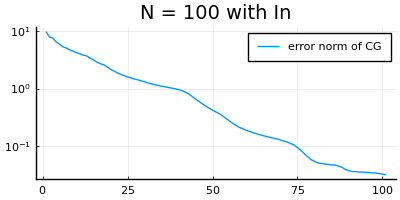

In [25]:
err_CG_100_with_diagm = h(100, A_100, b_100,true)
err_CG_100_without_diagm = h(100, A_100, b_100, false) 
plot(err_CG_100_with_diagm/norm(opt),yscale=:log10,label="error norm of CG",size=(400,200), title="N = 100 with In")

In [21]:
println("For n=100 and without adding In to A, the conditionning of A = ", cond(A_100), " and the error = ", err_CG_100_without_diagm[end])
println("For n=100 and with adding In to A, the conditionning of A = ", cond(A_100+ diagm(0=>ones(100))), " and the error = ", err_CG_100_with_diagm[end])

For n=100 and without adding In to A, the conditionning of A = 22869.757102770505 and the error = 36.45251282142719
For n=100 and with adding In to A, the conditionning of A = 396.28468297007146 and the error = 0.008623630429404656


##### We observe that when the matrix is better the conditionned, we have a smaller error. In fact adding the identity matrix diagm(0=>ones(n)) improves the conditionning of the matrix, this is because by adding ones to the eignenvalues of A we are increasing the smallest eigenvlue to be > 1 since the matrix is hermissian cond(M)= largest_eigenvalue/ smallest_eigenvalue. Therefore adding In lowers cond(A) and therefore gives a smaller error. 

### V - Polak-Ribière Method

Initialization: 

> 1. initialize ${\bf x_0}$ and calculate $\Delta {\bf x_0}$, where $\Delta {\bf x_n}= - \nabla f ({\bf x_n})$ 
> 2. $\alpha_0 = \arg \min_\alpha f({\bf x_0}+\alpha \Delta {\bf x_0})$
> 3. ${\bf x_1}={\bf x_0}+\alpha_0 \Delta {\bf x_0}$

Iterations: 

> 1. $\beta_{n} = \frac{\nabla f ({\bf x_n})^{\top} (\nabla f ( {\bf x_n})-\nabla f ({\bf x_{n-1}}))} {\nabla f ({\bf x_{n-1})^{\top}} \nabla f ({\bf x_{n-1}})}$
> 2. ${\bf d_n}= -\nabla f ({\bf x_n})+\beta_n {\bf d_{n-1}}$
> 3. $\alpha_n=\arg \min_{\alpha} f({\bf x_n}+\alpha {\bf d_n})$
> 4. ${\bf x_{n+1}}={\bf x_n}+\alpha_{n} {\bf d_n}$


In [ ]:
# Polak-Ribière
#---------------
init = [-4, -2]
function PolakRibiere(f, ∇f, init, opt, precision, max_iter,alpha)
    pt          = init
    nb_iter_PR  = 0        # number of iterations
    nb_loops_PR = 0        # number of inner loops count for backtracking
    resu_PR     = pt
    
    # initialization
    g_k = ∇p(pt[1], pt[2]) 
    d_k = - g_k
    err_PR = norm(pt.-opt)
    resu_PR = pt
    # iterations
    while norm(pt-opt)>precision && nb_iter_PR<max_iter
        nb_iter_PR  +=1
        pt , n = backtracking(pt,p,∇p, d_k, alpha)
        nb_loops_PR += n 
        g_k1 = ∇p(pt[1], pt[2]) 
        beta = (g_k1' *(g_k1 - g_k))/ (g_k' * g_k) 
        d_k1 = - g_k1 + beta * d_k
        g_k= g_k1
        d_k = d_k1
        resu_PR    = [resu_PR pt]
        err_PR = [err_PR;norm(pt.-opt)] 
    end
    return nb_iter_PR, nb_loops_PR, err_PR, resu_PR
end 

In [ ]:
init = [-4, -2]
nb_iter_PR, nb_loops_PR, err_PR, resu_PR = PolakRibiere(p, ∇p, init, opt, precision, max_iter,0.25)
resu_grad, nb_loops_grad , nb_iter_grad = gradient_descent_with_backtracking(p, ∇p, init, opt, precision, max_iter,0.25) 

In [19]:
println("Error with gradient = $(norm(resu_grad[:,end]-opt))")
println("Number of iterations = $nb_iter_grad")
println("Number of inner loops = $nb_loops_grad\n")

println("Error with Polack-Ribière = $(norm(resu_PR[:,end]-opt))")
println("Number of iterations = $nb_iter_PR")
println("Number of inner loops = $nb_loops_PR")

Error with gradient = 0.1858894615372752
Number of iterations = 100000
Number of inner loops = 10298364

Error with Polack-Ribière = 0.16963643425671654
Number of iterations = 100000
Number of inner loops = 10368280


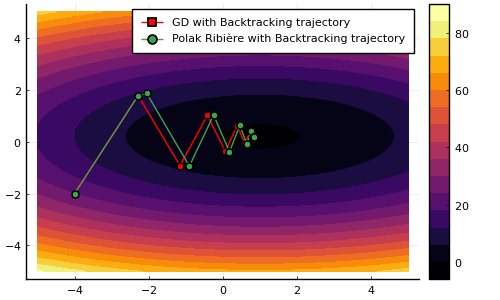

sys:1: UserWarning: The following kwargs were not used by contour: 'label'
sys:1: UserWarning: No data for colormapping provided via 'c'. Parameters 'vmin', 'vmax' will be ignored
sys:1: UserWarning: The following kwargs were not used by contour: 'label'
sys:1: UserWarning: No data for colormapping provided via 'c'. Parameters 'vmin', 'vmax' will be ignored
sys:1: UserWarning: The following kwargs were not used by contour: 'label'
sys:1: UserWarning: No data for colormapping provided via 'c'. Parameters 'vmin', 'vmax' will be ignored
sys:1: UserWarning: The following kwargs were not used by contour: 'label'
sys:1: UserWarning: No data for colormapping provided via 'c'. Parameters 'vmin', 'vmax' will be ignored


In [20]:
#Figure: Gradient and Polack-Ribière (with backtraking)
x = -5:0.1:5
y = -5:0.1:5
contourf(x, y, p) 
plot!(resu_grad[1, :], resu_grad[2, :], label="GD with Backtracking trajectory", marker=:square,markersize=5, color=:red, size=(500,300)) 
plot!(resu_PR[1, :], resu_PR[2, :] , label="Polak Ribière with Backtracking trajectory", marker=:circle,markersize=5) 